In [1]:
import pandas as pd
import numpy as np
import matplotlib as mlt
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency
import seaborn as sns
from random import randrange, uniform
from sklearn import preprocessing
import csv
import folium
from math import sin, cos, sqrt, atan2, radians
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline

In [2]:
month = pd.read_csv("yellow_tripdata_2015-12.csv")

In [4]:
month.dtypes

VendorID                   int64
tpep_pickup_datetime      object
tpep_dropoff_datetime     object
passenger_count            int64
trip_distance            float64
pickup_longitude         float64
pickup_latitude          float64
RatecodeID                 int64
store_and_fwd_flag        object
dropoff_longitude        float64
dropoff_latitude         float64
payment_type               int64
fare_amount              float64
extra                    float64
mta_tax                  float64
tip_amount               float64
tolls_amount             float64
improvement_surcharge    float64
total_amount             float64
dtype: object

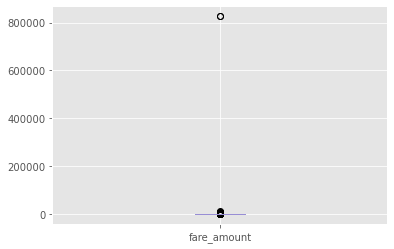

In [5]:
month.boxplot("fare_amount")

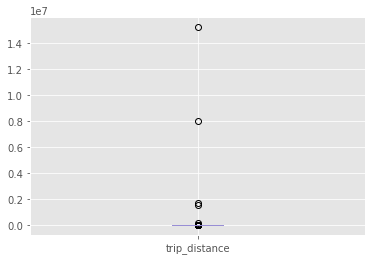

In [6]:
month.boxplot("trip_distance")

In [7]:
#pickup location
m = folium.Map(location=[40.767937,-73.982155 ],tiles='Stamen Terrain',
 zoom_start=12)
for each in month.sample(n=10000).iterrows():
    folium.CircleMarker([each[1]['pickup_latitude'],each[1]['pickup_longitude']],
                        radius=3,
                        color='blue',
                        popup=str(each[1]['pickup_latitude'])+','+str(each[1]['pickup_longitude']),
                        fill_color='blue'
                        ).add_to(m)
m

In [10]:
# Drop nulls
print("old: %d" %len(month))
month = month.dropna(how = 'any', axis = 'rows')
print("new: %d" %len(month)) # track data amount before and after deletion

old: 11460573
new: 11460573


In [12]:
# Remove observations with useless values base on the test data boundary
mask = month['pickup_longitude'].between(-74.3, -72.9)
mask &= month['dropoff_longitude'].between(-74.3, -72.9)
mask &= month['pickup_latitude'].between(40.5, 41.8)
mask &= month['dropoff_latitude'].between(40.5, 41.7)
mask &= month['passenger_count'].between(0, 6)
mask &= month['fare_amount'].between(2.5, 200)
mask &= month['trip_distance'].between(0, 90)
mask &= month['passenger_count'].between(1, 6)


print("old: %d" %len(month))
month = month[mask]
print("new: %d" %len(month)) # track data amount before and after deletion

old: 11264369
new: 11264333


In [13]:
month['fare_amount'].max()

200.0

In [14]:
# Convert to datetime for feature engineering
month_2 = month
month_2['tpep_pickup_datetime'] = pd.to_datetime(month['tpep_pickup_datetime'], format='%Y-%m-%d %H:%M:%S')

In [15]:
#Getting interger numbers from the pickup_datetime
month["hour"] = month_2.tpep_pickup_datetime.dt.hour
month["weekday"] = month_2.tpep_pickup_datetime.dt.weekday

In [16]:
#Function for distance calculation between coordinates as mapped variables
def sphere_dist(pickup_lat, pickup_lon, dropoff_lat, dropoff_lon):
    #Define earth radius (km)
    R_earth = 6371
    #Convert degrees to radians
    pickup_lat, pickup_lon, dropoff_lat, dropoff_lon = map(np.radians,
                                                             [pickup_lat, pickup_lon, 
                                                              dropoff_lat, dropoff_lon])
    #Compute distances along lat, lon dimensions
    dlat = dropoff_lat - pickup_lat
    dlon = dropoff_lon - pickup_lon
    
    #Compute haversine distance
    a = np.sin(dlat/2.0)**2 + np.cos(pickup_lat) * np.cos(dropoff_lat) * np.sin(dlon/2.0)**2
    
    return 2 * R_earth * np.arcsin(np.sqrt(a))

In [17]:
#Function for calculating distance between newly obtained distances from the hotspots.
def add_airport_dist(dataset):
    jfk_coord = (40.639722, -73.778889)
    ewr_coord = (40.6925, -74.168611)
    lga_coord = (40.77725, -73.872611)
    
    pickup_lat = dataset['pickup_latitude']
    dropoff_lat = dataset['dropoff_latitude']
    pickup_lon = dataset['pickup_longitude']
    dropoff_lon = dataset['dropoff_longitude']
    
    pickup_jfk = sphere_dist(pickup_lat, pickup_lon, jfk_coord[0], jfk_coord[1]) 
    dropoff_jfk = sphere_dist(jfk_coord[0], jfk_coord[1], dropoff_lat, dropoff_lon) 
    pickup_ewr = sphere_dist(pickup_lat, pickup_lon, ewr_coord[0], ewr_coord[1])
    dropoff_ewr = sphere_dist(ewr_coord[0], ewr_coord[1], dropoff_lat, dropoff_lon) 
    pickup_lga = sphere_dist(pickup_lat, pickup_lon, lga_coord[0], lga_coord[1]) 
    dropoff_lga = sphere_dist(lga_coord[0], lga_coord[1], dropoff_lat, dropoff_lon) 
    
    dataset['jfk_dist'] = pd.concat([pickup_jfk, dropoff_jfk], axis=1).min(axis=1)
    dataset['ewr_dist'] = pd.concat([pickup_ewr, dropoff_ewr], axis=1).min(axis=1)
    dataset['lga_dist'] = pd.concat([pickup_lga, dropoff_lga], axis=1).min(axis=1)
    
    return dataset

In [18]:
month = add_airport_dist(month)

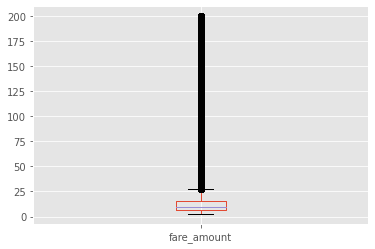

In [19]:
month.boxplot("fare_amount")

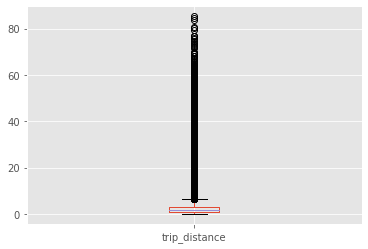

In [20]:
month.boxplot("trip_distance")

In [21]:
#pickup location
m = folium.Map(location=[40.767937,-73.982155 ],tiles='Stamen Terrain',
 zoom_start=12)
for each in month.sample(n=10000).iterrows():
    folium.CircleMarker([each[1]['pickup_latitude'],each[1]['pickup_longitude']],
                        radius=3,
                        color='blue',
                        popup=str(each[1]['pickup_latitude'])+','+str(each[1]['pickup_longitude']),
                        fill_color='blue'
                        ).add_to(m)
m

In [22]:
def time_analysis(df):
    return pd.DataFrame({"FareAverage":np.mean(df.fare_amount),"Count":np.size(df.fare_amount),"FareSum":sum(df.fare_amount)},index=["Time"] )

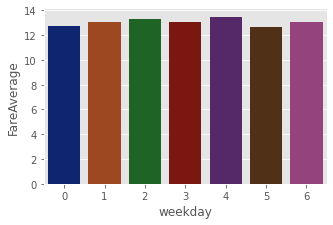

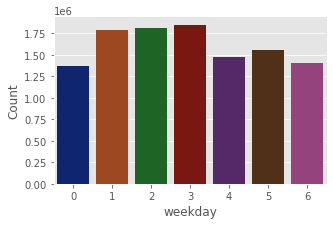

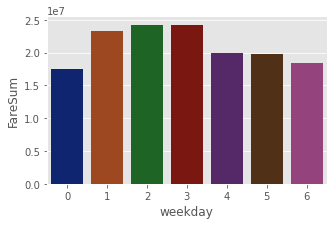

In [23]:
df_weekly=month.groupby('weekday').apply(time_analysis).reset_index()
sns.catplot(x="weekday", y="FareAverage", kind="bar", data=df_weekly,color="c",palette="dark",height=3, aspect=1.5)
sns.catplot(x="weekday", y="Count", kind="bar", data=df_weekly,color="g",palette="dark",height=3, aspect=1.5)
sns.catplot(x="weekday", y="FareSum", kind="bar", data=df_weekly,color="m",palette="dark",height=3, aspect=1.5)

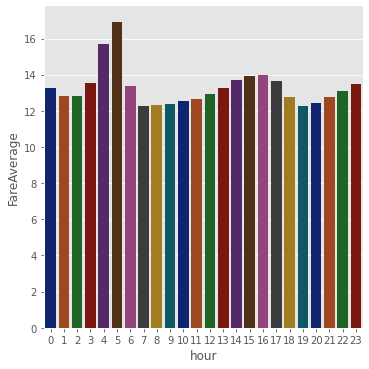

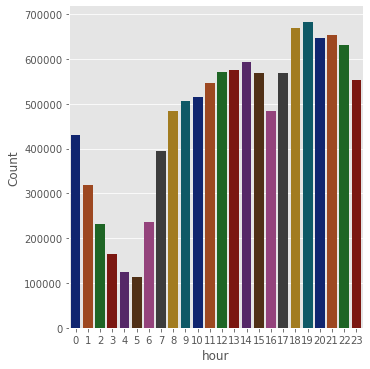

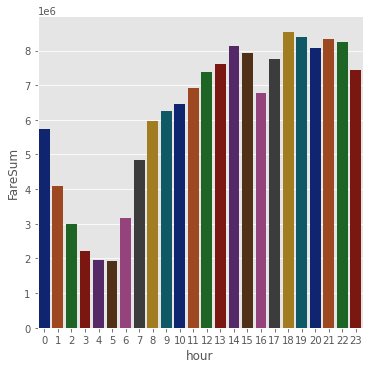

In [24]:
df_daily=month.groupby('hour').apply(time_analysis).reset_index()
sns.catplot(x="hour", y="FareAverage", kind="bar", data=df_daily,color="c",palette="dark",height=5, aspect=1)
sns.catplot(x="hour", y="Count", kind="bar", data=df_daily,color="g",palette="dark",height=5, aspect=1)
sns.catplot(x="hour", y="FareSum", kind="bar", data=df_daily,color="m",palette="dark",height=5, aspect=1)

In [25]:
month["passenger_count"] = month["passenger_count"].astype(object)

In [27]:
df2=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude","trip_distance", "weekday", "hour", "jfk_dist", "ewr_dist", "lga_dist", "fare_amount"]

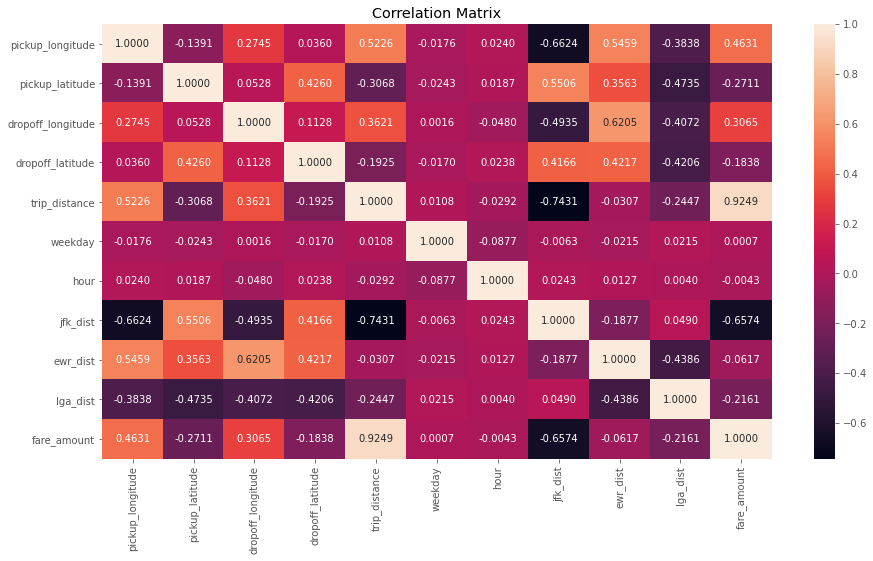

In [28]:
plt.figure(figsize=(15,8))
sns.heatmap(month[df2].corr(),annot=True,fmt='.4f')
plt.title('Correlation Matrix')
plt.show()

Text(0.5, 1.0, 'Trip Distance vs Fare Amount')

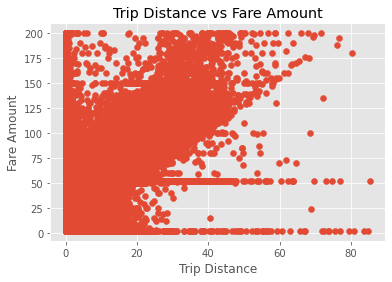

In [32]:
plt.scatter(x=month['trip_distance'],y=month['fare_amount'])
plt.xlabel("Trip Distance")
plt.ylabel("Fare Amount")
plt.title("Trip Distance vs Fare Amount")

Text(0.5, 1.0, 'jfk Distance vs Fare Amount')

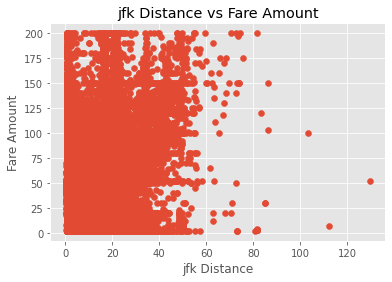

In [33]:
plt.scatter(x=month['jfk_dist'],y=month['fare_amount'])
plt.xlabel("jfk Distance")
plt.ylabel("Fare Amount")
plt.title("jfk Distance vs Fare Amount")

Text(0.5, 1.0, 'ewr Distance vs Fare Amount')

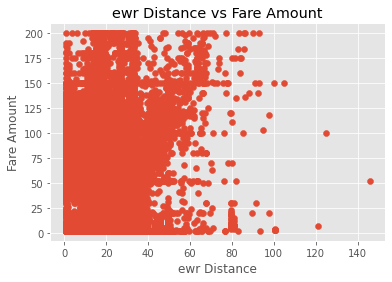

In [34]:
plt.scatter(x=month['ewr_dist'],y=month['fare_amount'])
plt.xlabel("ewr Distance")
plt.ylabel("Fare Amount")
plt.title("ewr Distance vs Fare Amount")

Text(0.5, 1.0, 'lga Distance vs Fare Amount')

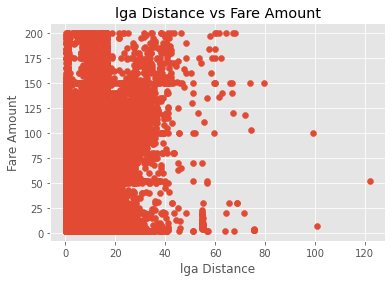

In [35]:
plt.scatter(x=month['lga_dist'],y=month['fare_amount'])
plt.xlabel("lga Distance")
plt.ylabel("Fare Amount")
plt.title("lga Distance vs Fare Amount")

In [36]:
from scipy import stats
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["trip_distance"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  0.9248772808748841 and a P-value of: 0.0


In [47]:
from scipy import stats
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["pickup_longitude"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  0.4631148045341543 and a P-value of: 0.0


In [37]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["weekday"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  0.0007372743256125712 and a P-value of: 0.013343473154515931


In [38]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["hour"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  -0.004286889702932494 and a P-value of: 6.165144723681284e-47


In [39]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["jfk_dist"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  -0.6574498743659525 and a P-value of: 0.0


In [40]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["ewr_dist"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  -0.06166036008806281 and a P-value of: 0.0


In [41]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["lga_dist"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  -0.21611302844608604 and a P-value of: 0.0


In [42]:
pearson_coef, p_value = stats.pearsonr(month["fare_amount"], month["passenger_count"])
print("Pearson Correlation Coefficient: ", pearson_coef, "and a P-value of:", p_value) 

Pearson Correlation Coefficient:  0.015937348689305478 and a P-value of: 0.0


In [43]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

In [44]:
def processDataForModelling(data,target,drop_cols,is_train=True,split=0.25):
    data_1=data.drop(drop_cols,axis=1)
    # One hot Encoding
    data_1=pd.get_dummies(data_1)
    if is_train==True:
        X=data_1.drop([target],axis=1)
        y=data_1[target]
        X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=split,random_state=123)
        return X_train, X_test, y_train, y_test
    else:
        return data_1


In [48]:
X_train, X_test, y_train, y_test=processDataForModelling(month,'fare_amount',drop_cols=["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude","VendorID","tpep_pickup_datetime","tpep_dropoff_datetime","RatecodeID","store_and_fwd_flag","payment_type","extra","mta_tax","tip_amount","improvement_surcharge","tolls_amount","total_amount", "weekday"],is_train=True,split=0.2)

In [50]:
baseline_pred=np.repeat(avg_fare,y_test.shape[0])
baseline_rmse=np.sqrt(mean_squared_error(baseline_pred, y_test))
print("Basline RMSE of Validation data :",baseline_rmse)

Basline RMSE of Validation data : 10.7585482913871


In [54]:
import statsmodels.api as sm
from statsmodels.formula.api import *
fit = ols(formula="fare_amount ~ passenger_count + trip_distance + jfk_dist + ewr_dist + lga_dist + weekday + hour", data=month).fit()

In [55]:
print(fit.summary())

                            OLS Regression Results                            
Dep. Variable:            fare_amount   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.859
Method:                 Least Squares   F-statistic:                 6.214e+06
Date:                Fri, 09 Oct 2020   Prob (F-statistic):               0.00
Time:                        11:06:47   Log-Likelihood:            -3.1734e+07
No. Observations:            11264333   AIC:                         6.347e+07
Df Residuals:                11264321   BIC:                         6.347e+07
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept                1.0630 

In [56]:
fit = ols(formula="fare_amount ~ trip_distance + jfk_dist + ewr_dist + lga_dist + hour", data=month).fit()

In [57]:
print(fit.summary())

                            OLS Regression Results                            
Dep. Variable:            fare_amount   R-squared:                       0.858
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                 1.366e+07
Date:                Fri, 09 Oct 2020   Prob (F-statistic):               0.00
Time:                        11:06:59   Log-Likelihood:            -3.1738e+07
No. Observations:            11264333   AIC:                         6.348e+07
Df Residuals:                11264327   BIC:                         6.348e+07
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.9332      0.023     39.820

In [58]:
fit = ols(formula="fare_amount ~ trip_distance + jfk_dist + ewr_dist + lga_dist", data=month).fit()

In [59]:
print(fit.summary())

                            OLS Regression Results                            
Dep. Variable:            fare_amount   R-squared:                       0.858
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                 1.700e+07
Date:                Fri, 09 Oct 2020   Prob (F-statistic):               0.00
Time:                        11:07:05   Log-Likelihood:            -3.1758e+07
No. Observations:            11264333   AIC:                         6.352e+07
Df Residuals:                11264328   BIC:                         6.352e+07
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         1.3902      0.023     59.488

In [60]:
fit = ols(formula="fare_amount ~ trip_distance + jfk_dist ", data=month).fit()

In [61]:
print(fit.summary())

                            OLS Regression Results                            
Dep. Variable:            fare_amount   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.857
Method:                 Least Squares   F-statistic:                 3.386e+07
Date:                Fri, 09 Oct 2020   Prob (F-statistic):               0.00
Time:                        11:07:09   Log-Likelihood:            -3.1779e+07
No. Observations:            11264333   AIC:                         6.356e+07
Df Residuals:                11264330   BIC:                         6.356e+07
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.7380      0.011     69.059

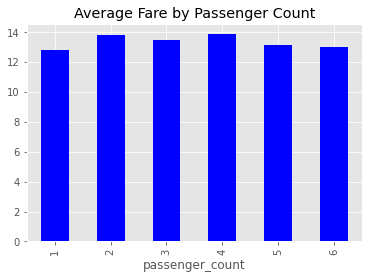

In [62]:
month.groupby('passenger_count')['fare_amount'].mean().plot.bar(color = 'b');
plt.title('Average Fare by Passenger Count');

In [87]:
month_3=month.drop(["pickup_longitude","pickup_latitude","dropoff_longitude","dropoff_latitude","VendorID","tpep_pickup_datetime","tpep_dropoff_datetime","RatecodeID","store_and_fwd_flag","payment_type","extra","mta_tax","tip_amount","improvement_surcharge","tolls_amount","total_amount"],axis=1)
month_3.head()

,passenger_count,trip_distance,fare_amount,hour,weekday,jfk_dist,ewr_dist,lga_dist
0,5,0.96,5.5,0,1,20.923473,17.844336,8.046046
1,2,2.69,21.5,0,1,21.259097,15.901436,8.559307
2,1,2.62,17.0,0,1,21.190188,18.641215,8.226799
3,1,1.20,6.5,0,1,21.384013,15.649427,10.957120
4,2,3.00,11.0,0,1,17.765534,15.623681,11.279319


In [88]:
month_3["passenger_count"] = month_3["passenger_count"].astype(object)
month_3["hour"] = month_3["hour"].astype(object)

In [89]:
month_3 = pd.get_dummies(month_3, drop_first=True)

In [90]:
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
x = month_3.drop('fare_amount',axis=1).values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
X = pd.DataFrame(x_scaled)
y = month_3['fare_amount'].values

In [91]:
from statsmodels.tools.eval_measures import rmse
model = sm.OLS(y,X).fit()
ypred = model.predict(X)
rmse = rmse(y, ypred)

In [92]:
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.944
Model:                            OLS   Adj. R-squared (uncentered):              0.944
Method:                 Least Squares   F-statistic:                          5.782e+06
Date:                Fri, 09 Oct 2020   Prob (F-statistic):                        0.00
Time:                        11:54:36   Log-Likelihood:                     -3.1587e+07
No. Observations:            11264333   AIC:                                  6.317e+07
Df Residuals:                11264300   BIC:                                  6.317e+07
Df Model:                          33                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [93]:
rmse

3.9957617736271307